## Results for UK-DALE dataset

In [1]:
from data import UKDALEData
import matplotlib.pyplot as plt
import pandas as pd
from modelGen import modelGen
from metrics import mae, rmse,nep,eac
from address import get_model_path
%matplotlib inline

from bokeh.plotting import figure, show
from bokeh.io import output_notebook
import numpy as np
output_notebook()

2023-12-14 01:51:05.068447: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.


Loading BokehJS ...

Reading data and processing test data

In [2]:
dataGen = UKDALEData(path="./data/")
trainMain,trainTargets, trainStates = dataGen.get_train_sequences(houses = 1,
                                                                  start = "2015-01-01",
                                                                  end="2016-01-01")
testMain,testTargets, testStates = dataGen.get_test_sequences(houses = 1,
                                                              start = "2016-01-01",
                                                              end="2016-02-01",
                                                              norm=False)

data= {"X_train":trainMain,
        "Y_train":trainTargets,
        "Y_states":trainStates,
        "Z_train":trainStates,
        "X_test":testMain,
        "Y_test":testTargets,
        "Z_test":testStates,
        "app_data":dataGen.get_app_data(),
        "main_data": dataGen.get_main_mean_std()
        } 

## SINGLE-TARGET results


In [3]:
MODELSID = ["dAE","biLSTM","FCNdAE","multiUNET","multiFCNdAE"]
#MODELSID = ["multiUNET"]
APP_LABELS = list(data["app_data"].keys())
SCORES = []
MODELS = []
METRICS = [mae,rmse]
METRICS_LAB = ["MAE","RMSE"]

for modelID in MODELSID:
    MODELS.append(modelGen(modelID=modelID,data=data, params = {}))
    MODELS[-1].load(get_model_path("UKDALE",modelID))
    mtrc = MODELS[-1].evaluate(data["X_test"],
                                data["Y_test"],
                                data["Z_test"],
                                metrics=[mae,eac])
    
    SCORES+=mtrc

Building model
loading best hyperparameters
FCNdAE
multiFCNdAE
multiUNET
UNET
dAE
Building model: dAE [keras]
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, 100, 8)            40        
                                                                 
 flatten (Flatten)           (None, 800)               0         
                                                                 
 dense (Dense)               (None, 800)               640800    
                                                                 
 dropout (Dropout)           (None, 800)               0         
                                                                 
 dense_1 (Dense)             (None, 128)               102528    
                                                                 
 dense_2 (Dense)             (None, 800)               103200    
            

2023-12-14 01:51:24.749764: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-12-14 01:51:24.997898: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1532] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 22311 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3090, pci bus id: 0000:01:00.0, compute capability: 8.6


restoring weights of model dAE from path: /home/diego/repositorios/NCA23_nilm/results/UKDALE/dAE/dAE_kettle
restoring weights of model dAE from path: /home/diego/repositorios/NCA23_nilm/results/UKDALE/dAE/dAE_fridge
restoring weights of model dAE from path: /home/diego/repositorios/NCA23_nilm/results/UKDALE/dAE/dAE_dish washer
restoring weights of model dAE from path: /home/diego/repositorios/NCA23_nilm/results/UKDALE/dAE/dAE_washing machine
restoring weights of model dAE from path: /home/diego/repositorios/NCA23_nilm/results/UKDALE/dAE/dAE_microwave


2023-12-14 01:51:25.767281: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8100


47/47 [==============================] - 0s 704us/step


2023-12-14 01:51:26.478760: I tensorflow/stream_executor/cuda/cuda_blas.cc:1786] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


47/47 [==============================] - 0s 740us/step
Building model
loading best hyperparameters
FCNdAE
multiFCNdAE
multiUNET
UNET
dAE
biLSTM
Building model: biLSTM [keras]
Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_10 (Conv1D)          (None, 101, 16)           80        
                                                                 
 bidirectional (Bidirectiona  (None, 101, 256)         148480    
 l)                                                              
                                                                 
 bidirectional_1 (Bidirectio  (None, 512)              1050624   
 nal)                                                            
                                                                 
 dense_15 (Dense)            (None, 128)               65664     
                                                                 
 dense_16 (

In [4]:
scores_df = pd.DataFrame(data=SCORES,columns = ["APP","SCORE","METRIC","MODEL"])
table_metrics_single = pd.pivot_table(scores_df, values='SCORE', index=['METRIC', 'MODEL'],columns=['APP'],sort=False)
table_metrics_single

APP                 dish washer    fridge     kettle  microwave  \
METRIC MODEL                                                      
mae    dAE            25.039253  8.794954   7.766203   4.445693   
       biLSTM         23.804802  3.940149  12.973200   4.713210   
       FCNdAE          6.451356  3.926539   3.803681   2.494870   
       multiUNET      16.735433  9.595609   3.203956   3.922781   
       multiFCNdAE     3.768047  4.999142   3.648084   4.241935   
eac    dAE             0.703014  0.878949   0.788976   0.786234   
       biLSTM          0.717655  0.945769   0.647491   0.773370   
       FCNdAE          0.923482  0.945956   0.896646   0.880037   
       multiUNET       0.801504  0.867929   0.912942   0.811377   
       multiFCNdAE     0.955308  0.931193   0.900874   0.796031   

APP                 washing machine  
METRIC MODEL                         
mae    dAE                30.427824  
       biLSTM             11.687105  
       FCNdAE              3.705609  
       multiUNET          15.523937  
       multiFCNdAE         6.577410  
eac    dAE                 0.424711  
       biLSTM              0.779036  
       FCNdAE              0.929939  
       multiUNET           0.706494  
       multiFCNdAE         0.875643

In [7]:
print(table_metrics_single.to_latex(float_format="%2.3f",multirow=True))

\begin{tabular}{llrrrrr}
\toprule
    & APP &  dish washer &  fridge &  kettle &  microwave &  washing machine \\
METRIC & MODEL &              &         &         &            &                  \\
\midrule
\multirow{5}{*}{mae} & dAE &       25.039 &   8.795 &   7.766 &      4.446 &           30.428 \\
    & biLSTM &       23.805 &   3.940 &  12.973 &      4.713 &           11.687 \\
    & FCNdAE &        6.451 &   3.927 &   3.804 &      2.495 &            3.706 \\
    & multiUNET &       16.735 &   9.596 &   3.204 &      3.923 &           15.524 \\
    & multiFCNdAE &        3.768 &   4.999 &   3.648 &      4.242 &            6.577 \\
\cline{1-7}
\multirow{5}{*}{eac} & dAE &        0.703 &   0.879 &   0.789 &      0.786 &            0.425 \\
    & biLSTM &        0.718 &   0.946 &   0.647 &      0.773 &            0.779 \\
    & FCNdAE &        0.923 &   0.946 &   0.897 &      0.880 &            0.930 \\
    & multiUNET &        0.802 &   0.868 &   0.913 &      0.811 &            0.7

/tmp/ipykernel_1110822/1696693913.py:1: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  print(table_metrics_single.to_latex(float_format="%2.3f",multirow=True))


## Estimations

In [5]:
# Getting a disaggregated sequence 

n_samples = 600*24*7 # 1 week of data
disagg_est = [model.predict(data["X_test"][:n_samples]) for model in MODELS]
disagg    = [ data["Y_test"][ii][:n_samples] for ii,app in enumerate(dataGen.get_app_data().keys())]

11/11 [==============================] - 0s 1ms/step


21/21 [==============================] - 0s 16ms/step


## Qualitative results

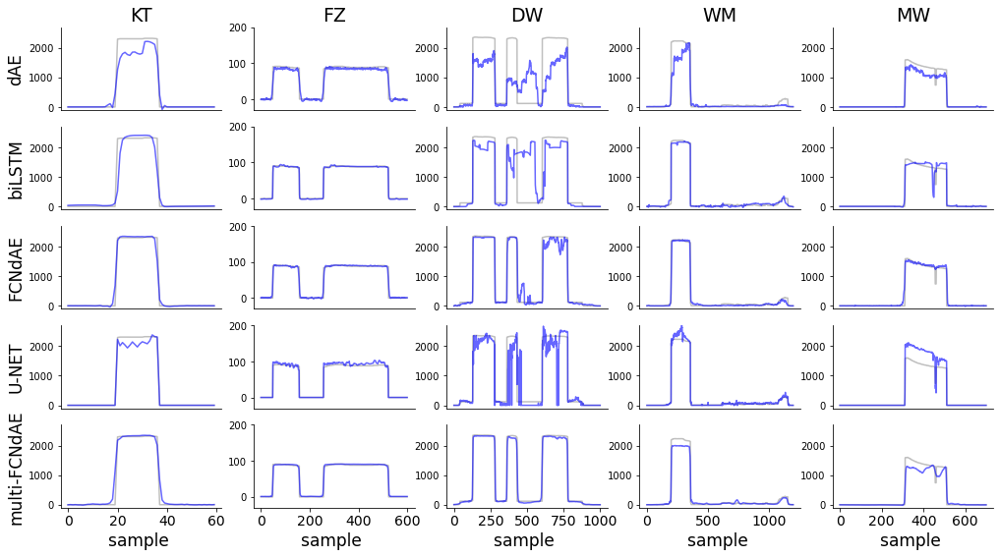

In [9]:
from itertools import product
MODELLABELS = ["dAE","biLSTM","FCNdAE","U-NET","multi-FCNdAE"]
APP_LABEL_ART = ["KT","FZ","DW","WM","MW"]
rows = len(MODELS)
columns = len(data["app_data"].keys())
# Selected idxs
start = [21420,27600,79200,50500,36000]
stop  = [21480,28200,80200,51700,36700]
plt.figure("Results UKDALE",figsize=(17,9))
plt.clf()
for ii,(model,app) in enumerate(product(range(rows),range(columns))):
    #print(f"{ii}-{MODELSID[model]}-{APP_LABELS[app]}")
    ax =plt.subplot(rows,columns, ii+1)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)    
    plt.plot(disagg[app][start[app]:stop[app]],c="gray",alpha=0.5, label="Ground truth")
    plt.plot(disagg_est[model][app][start[app]:stop[app]],c="blue",alpha=0.6, label="Ground truth")
    if APP_LABEL_ART[app] == "FZ":
        plt.ylim(-30,200)
    else:
        plt.ylim(-100,2700)
    ## Labels
    if model ==0:
       ax.set_title(f"{APP_LABEL_ART[app]}",fontdict={'fontsize':19}) 
    if app  ==0:
        ax.set_ylabel(MODELLABELS[model],fontdict={'fontsize':17})
    if model == rows-1:
        plt.xticks(fontsize=14)
        plt.xlabel("sample ",fontdict={'fontsize':17})
    else:
        ax.set_xticks([])

0-dAE-kettle
1-dAE-fridge
2-dAE-dish washer
3-dAE-washing machine
4-dAE-microwave
5-biLSTM-kettle
6-biLSTM-fridge
7-biLSTM-dish washer
8-biLSTM-washing machine
9-biLSTM-microwave
10-FCNdAE-kettle
11-FCNdAE-fridge
12-FCNdAE-dish washer
13-FCNdAE-washing machine
14-FCNdAE-microwave
15-multiFCNdAE-kettle
16-multiFCNdAE-fridge
17-multiFCNdAE-dish washer
18-multiFCNdAE-washing machine
19-multiFCNdAE-microwave


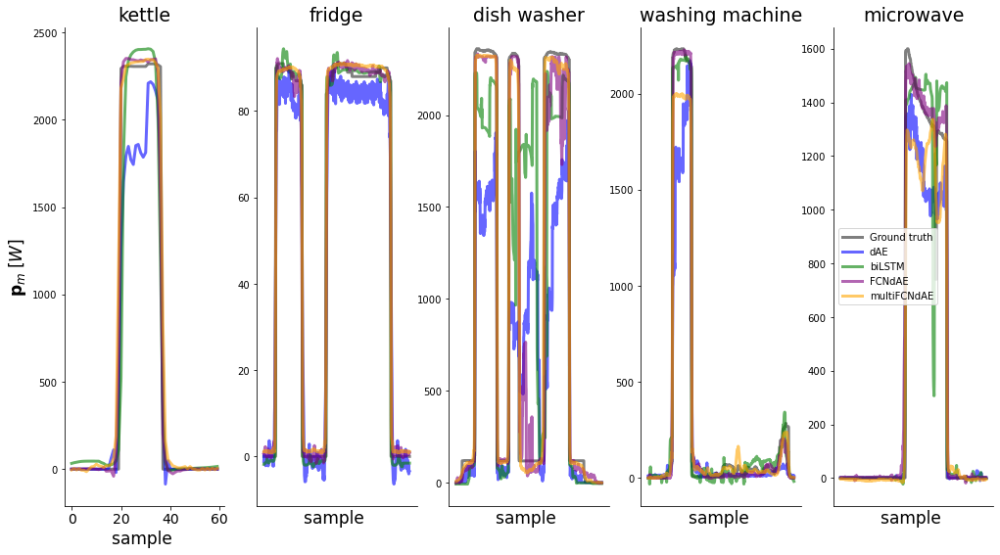

In [7]:
from itertools import product

rows = 1
columns = len(data["app_data"].keys())
# Selected idxs
start = [21420,27600,79200,50500,36000]
stop  = [21480,28200,80200,51700,36700]
colors = ["blue","green","purple","orange"]
plt.figure("Results single-target UKDALE",figsize=(17,9))
plt.clf()
for ii,(model,app) in enumerate(product(range(len(MODELS)),range(columns))):
    print(f"{ii}-{MODELSID[model]}-{APP_LABELS[app]}")
    ax =plt.subplot(rows,columns, ii%columns+1)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)    
    ## Labels
    if model ==0:
       ax.set_title(f"{APP_LABELS[app]}",fontdict={'fontsize':19}) 
       plt.plot(disagg[app][start[app]:stop[app]],c="black",alpha=0.5, linewidth=3, label="Ground truth")
       plt.xticks(fontsize=14)
       plt.xlabel("sample ",fontdict={'fontsize':17})

    if app  ==0:
        ax.set_ylabel(r"$ \mathbf{p}_m \; [W]$",fontdict={'fontsize':17})
    else:
        ax.set_xticks([])
    plt.plot(disagg_est[model][app][start[app]:stop[app]],c=colors[model],linewidth=3,alpha=0.6, label=MODELSID[model])
plt.legend()

## All models

In [1]:
MODELSID = ["FCNdAE","multiFCNdAE","multiUNET"]
#MODELSID = ["multiUNET"]
APP_LABELS = list(data["app_data"].keys())
SCORES = []
MODELS = []
METRICS = [mae,rmse]
METRICS_LAB = ["MAE","RMSE"]

for modelID in MODELSID:
    MODELS.append(modelGen(modelID=modelID,data=data, params = {}))
    MODELS[-1].load(get_model_path("UKDALE",modelID))
    mtrc = MODELS[-1].evaluate(data["X_test"],
                                data["Y_test"],
                                data["Z_test"],
                                metrics=[mae,nep,eac])
    
    SCORES+=mtrc

NameError: name 'data' is not defined

In [4]:

scores_df = pd.DataFrame(data=SCORES,columns = ["APP","SCORE","METRIC","MODEL"])
table_metrics = pd.pivot_table(scores_df, values='SCORE', index=['METRIC', 'MODEL'],columns=['APP'],sort=False)
table_metrics

APP                 dish washer    fridge    kettle  microwave  \
METRIC MODEL                                                     
mae    FCNdAE          6.451356  3.926539  3.803681   2.494870   
       multiFCNdAE     4.250574  5.021015  3.656267   4.242556   
       multiUNET      16.735433  9.595609  3.203956   3.922781   
nep    FCNdAE          0.153037  0.108087  0.206708   0.239926   
       multiFCNdAE     0.100831  0.138215  0.198697   0.407997   
       multiUNET       0.396992  0.264142  0.174116   0.377245   
eac    FCNdAE          0.923482  0.945956  0.896646   0.880037   
       multiFCNdAE     0.949585  0.930892  0.900652   0.796001   
       multiUNET       0.801504  0.867929  0.912942   0.811377   

APP                 washing machine  
METRIC MODEL                         
mae    FCNdAE              3.705609  
       multiFCNdAE         6.578614  
       multiUNET          15.523937  
nep    FCNdAE              0.140121  
       multiFCNdAE         0.248759  
       multiUNET           0.587012  
eac    FCNdAE              0.929939  
       multiFCNdAE         0.875620  
       multiUNET           0.706494

In [5]:
print(table_metrics.to_latex())

\begin{tabular}{llrrrrr}
\toprule
    & APP &  dish washer &    fridge &    kettle &  microwave &  washing machine \\
METRIC & MODEL &              &           &           &            &                  \\
\midrule
mae & FCNdAE &     6.451356 &  3.926539 &  3.803681 &   2.494870 &         3.705609 \\
    & multiFCNdAE &     4.250574 &  5.021015 &  3.656267 &   4.242556 &         6.578614 \\
    & multiUNET &    16.735433 &  9.595609 &  3.203956 &   3.922781 &        15.523937 \\
nep & FCNdAE &     0.153037 &  0.108087 &  0.206708 &   0.239926 &         0.140121 \\
    & multiFCNdAE &     0.100831 &  0.138215 &  0.198697 &   0.407997 &         0.248759 \\
    & multiUNET &     0.396992 &  0.264142 &  0.174116 &   0.377245 &         0.587012 \\
eac & FCNdAE &     0.923482 &  0.945956 &  0.896646 &   0.880037 &         0.929939 \\
    & multiFCNdAE &     0.949585 &  0.930892 &  0.900652 &   0.796001 &         0.875620 \\
    & multiUNET &     0.801504 &  0.867929 &  0.912942 &   0.811377

/tmp/ipykernel_916414/321211578.py:1: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  print(table_metrics.to_latex())


## Visualizing the disaggregations

In [6]:
n_samples = 600*24*7 # 1 week of data
disagg_est = [model.predict(data["X_test"][:n_samples]) for model in MODELS]
disagg    = [ data["Y_test"][ii][:n_samples] for ii,app in enumerate(dataGen.get_app_data().keys())]
colors = ["blue","green","orange","purple"]
figs = [figure(title=f"Results {app}",width=900,height=350) for app in dataGen.get_app_data().keys()]
for jj, model in enumerate(MODELSID):
    for ii,app in enumerate(dataGen.get_app_data().keys()):
        p = figs[ii] 
        app_target_est = disagg_est[jj][ii]                
        p.line(np.arange(len(app_target_est)), app_target_est, line_color=colors[jj],line_alpha=0.4, legend_label=f"{model}")


for ii,app in enumerate(dataGen.get_app_data().keys()):
    p = figs[ii] 
    app_target = disagg[ii]
    p.line(np.arange(len(app_target)), app_target, line_color="gray",line_alpha=0.4, legend_label="Ground truth")
    show(p)

3/3 [==============================] - 0s 2ms/step


202/202 [==============================] - 1s 6ms/step


0-FCNdAE-kettle
1-FCNdAE-fridge
2-FCNdAE-dish washer
3-FCNdAE-washing machine
4-FCNdAE-microwave
5-multiFCNdAE-kettle
6-multiFCNdAE-fridge
7-multiFCNdAE-dish washer
8-multiFCNdAE-washing machine
9-multiFCNdAE-microwave
10-multiUNET-kettle
11-multiUNET-fridge
12-multiUNET-dish washer
13-multiUNET-washing machine
14-multiUNET-microwave


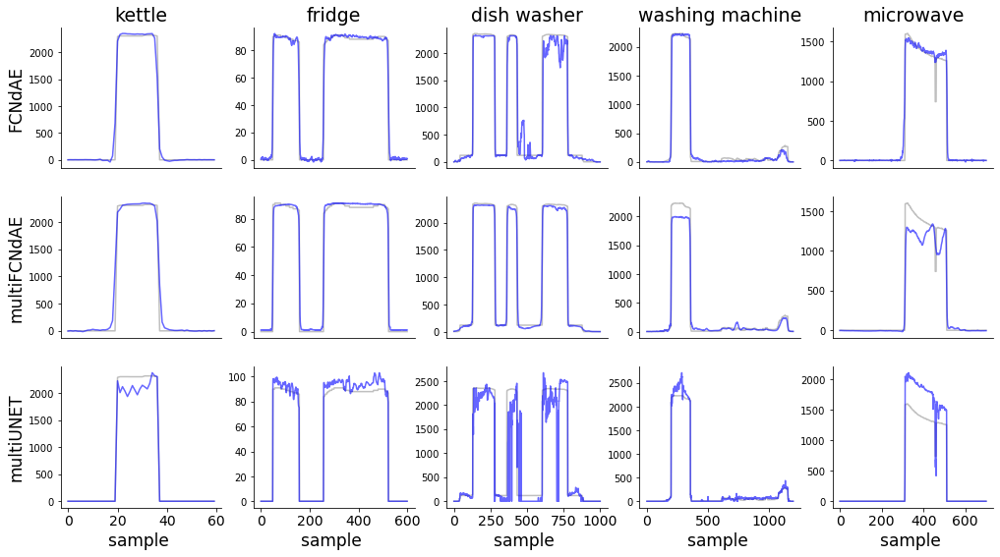

In [7]:
from itertools import product

rows = len(MODELS)
columns = len(data["app_data"].keys())
# Selected idxs
start = [21420,27600,79200,50500,36000]
stop  = [21480,28200,80200,51700,36700]
plt.figure("Results UKDALE",figsize=(17,9))
plt.clf()
for ii,(model,app) in enumerate(product(range(rows),range(columns))):
    print(f"{ii}-{MODELSID[model]}-{APP_LABELS[app]}")
    ax =plt.subplot(rows,columns, ii+1)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)    
    plt.plot(disagg[app][start[app]:stop[app]],c="gray",alpha=0.5, label="Ground truth")
    plt.plot(disagg_est[model][app][start[app]:stop[app]],c="blue",alpha=0.6, label="Ground truth")
    
    ## Labels
    if model ==0:
       ax.set_title(f"{APP_LABELS[app]}",fontdict={'fontsize':19}) 
    if app  ==0:
        ax.set_ylabel(MODELSID[model],fontdict={'fontsize':17})
    if model == rows-1:
        plt.xticks(fontsize=14)
        plt.xlabel("sample ",fontdict={'fontsize':17})
    else:
        ax.set_xticks([])

In [8]:
columns

5